# Resynthesizing sound via spectogram

After we took a look how we can generate sounds via numpy we want to take a look how we can re-synthesize a signal using numpy and some machine learning algorithms we have learned.
This allows us to yield interesting high-quality sounds without relying on neural networks that are really exhausive on resources.

Instead of writing audio analysis algorithms from scratch we can use the library [librosa](https://librosa.org/doc/latest/index.html) which is a library build on top of numpy.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import librosa
import librosa.display
import soundfile
from IPython.display import display, Audio

# remove warning in plotting via librosa
import warnings
import matplotlib.cbook
warnings.filterwarnings("ignore",category=matplotlib.cbook.mplDeprecation)

np.random.seed(42)

mpl.rcParams['figure.figsize'] = (15, 8)

## Loading a sound file

In [ ]:
path = 'violin.flac'
data, sr = librosa.load(path, sr=44100, mono=True)
display(Audio(path))

We start by loading a file. We specify the samplerate of $44'100~\text{Hz}$ because otherwise librosa will sample it down to $22'050~\text{Hz}$ which is handier from an algorithm perspective but not so pleasing from an aesthetic experience.
We will also reduce the signal to mono but this could be an interesting extension of the algorithm.

As [`librosa.load`](https://librosa.org/doc/main/generated/librosa.load.html) returns two values we can unpack this list by declaring two values on the left side.

For this notebook we will use [Violin silly.wav](https://freesound.org/people/cms4f/sounds/159160/) from [freesound.org](https://freesound.org/) (converted to 16 bit FLAC from 24 bit WAV) but you are welcome to exchange the file with another one.

We can take a look at `data` which is simply an array of the amplitude floats.

In [ ]:
data

array([ 4.4250488e-04,  1.1291504e-03,  2.4871826e-03, ...,
       -1.6784668e-04, -1.0681152e-04, -9.1552734e-05], dtype=float32)

In [ ]:
data.shape

(1218263,)

We see that data is a single vector.
We can verify if the samples have a length of 28 seconds using the samplerate of $44'100~\text{Hz}$.

In [ ]:
data.shape[0]/44100

27.625011337868482

## FFT

[Fast Fourier Transformation](https://en.wikipedia.org/wiki/Fast_Fourier_transform) (FFT) allows us to analyse the frequencies of a given signal.
But as we are not only interested in the frequencies of our signal but also when which frequency has which amplitude we use the the [short time foureur transform](https://en.wikipedia.org/wiki/Short-time_Fourier_transform) (STFT) which is basically FFT combined with a [sliding window](https://numpy.org/devdocs/reference/generated/numpy.lib.stride_tricks.sliding_window_view.html) aproach. 
By wanting to determine the amplitude of the frequency and the exact timing we got ourselves into trouble as there is always a trade-off between both - a circumstance described by the famous [uncertainty principle](https://en.wikipedia.org/wiki/Uncertainty_principle).

We define the variables `WIN_LENGTH` which is the size of our window in samples, `HOP_LENGTH` which is the number of samples between each window and `N_FFT` the number of frequency bins used to analyse the signal.

Depending on the length of your choosen sound file you want to play with these parameters as they are important for the performance and aesthetics of our generated material.

In [ ]:
WIN_LENGTH = int(sr/4)
HOP_LENGTH = int(sr/8)
N_FFT = sr

data_fft = librosa.stft(data, n_fft=N_FFT, hop_length=HOP_LENGTH, win_length=WIN_LENGTH)
data_fft.shape

(22051, 222)

The mono signal got transfered to a 2 dimensional array where the first dimension gives us the number of frequency bins and the second dimension the number of time windows used.

We can verify the number of windows via

In [ ]:
data.shape[0]/HOP_LENGTH

221.02013788098694

We can now take a look at the raw data of the STFT.

In [ ]:
data_fft

array([[-0.0561191 +0.0000000e+00j, -0.1048092 +0.0000000e+00j,
        -0.0865206 +0.0000000e+00j, ..., -0.08472604+0.0000000e+00j,
        -0.16148883+0.0000000e+00j,  0.16226637+0.0000000e+00j],
       [ 0.06052879-2.2969368e-06j,  0.10637848-1.0680067e-02j,
         0.08276885-1.0413539e-02j, ...,  0.08744626+6.1246011e-02j,
         0.17035262-1.0731176e-02j, -0.15652214+1.6692360e-03j],
       [-0.07380835+6.2095091e-06j, -0.11058487+1.7935030e-02j,
        -0.07181447+2.0844478e-02j, ..., -0.09436506-1.1998403e-01j,
        -0.19479181+2.1955252e-02j,  0.13900669-2.3784523e-03j],
       ...,
       [-0.00501067+3.7535558e-06j, -0.01410535+7.1933600e-03j,
         0.00118745+1.9640701e-03j, ...,  0.0005138 +4.5773204e-04j,
        -0.00083155+6.4618391e-04j,  0.00147615-3.9850598e-05j],
       [ 0.00805192-2.1926087e-06j,  0.01544397-3.6964316e-03j,
        -0.00143978-9.6498791e-04j, ..., -0.00038858-2.5692559e-04j,
         0.00060867-3.4790434e-04j, -0.00186472+1.8413844e-05j]

We see that the datatype of our scalars are a new type we have not seen before, *complex numbers*.
Those numbers have a *real* part and an *imaginary* part which is expressed in mulitples of $i$ where $i = \sqrt{-1}$.
It is important to remark that $\sqrt{-1} \notin \mathbb{R}$.

The complex numbers have some remarkable attributes which are researched in [*Funktionentheorie*](https://de.wikipedia.org/wiki/Funktionentheorie), one of the most elegant fields in mathematics.
For now we can think of the complex numbers more like a 2 dimensional vector - the first one pointing in the real domain and the other in the complex domain.
A recommended read for this topic is {cite}`Königsberger2013`.

In signal theory complex numbers are often used to represent the phase of a signal as it is equally important to the amplitude to re-construct the signal.
Otherwhise how would we properly reconstruct the audio of e.g. $440~\text{Hz}$ sine wave when not knowing at which angle/phase the sine wave is at each point.

We can nonetheless just get rid of the phase as an artistic choice which gives us an interesting kind of distortion.
To get rid of the phase we can use the [*absolute* function on complex numbers](https://en.wikipedia.org/wiki/Absolute_value#Complex_numbers) which calculates the euclidian distance from $(0,0)$ to our 2 dimensional vector in the complex plane.

To generate a signal based on frequency, phase and amplitude we can use the ISTFT which is an inversed STFT.

In [ ]:
data_inverted = librosa.istft(data_fft, hop_length=HOP_LENGTH, win_length=WIN_LENGTH)
display(Audio(data_inverted, rate=sr))

### Modifying the FFT matrix

We can also modify the FFT signal by keeping e.g. the imaginary comopnent fixed.

In [ ]:
data_fft_w_fixed_imag = np.copy(data_fft)
# set imaginary fixed to 1
data_fft_w_fixed_imag.imag = 1

display(Audio(
    data=librosa.istft(data_fft_w_fixed_imag, hop_length=HOP_LENGTH, win_length=WIN_LENGTH),
    rate=sr
))

We can use some array slicing in numpy to re-arange the order of our FFT matrix.
From {ref}`working-with-matrices` we know that Python and numpy use the notion of

```
start:stop:step_size
```

for the selection and re-arranging of arrays where, if not defined, the start is 0 and the stop is the end of the array and the step size is one.
Therefore `::-1` reverses the array.
We use `:` to keep the dimension untouced.

We start by inversing the second axis which is the time domain.

In [ ]:
display(Audio(
    data=librosa.istft(
        stft_matrix=data_fft[:, ::-1],
        hop_length=HOP_LENGTH,
        win_length=WIN_LENGTH
    ),
    rate=sr,
))

We can also reverse the order of the bins which is the first dimension of our FFT matrix.

In [ ]:
display(Audio(
    data=librosa.istft(
        stft_matrix=data_fft[::-1, :],
        hop_length=HOP_LENGTH,
        win_length=WIN_LENGTH
    ),
    rate=sr,
))

We can also scramble the fft bins for both dimensions.
For this we use `np.arange` to create a line of $n$ numbers and use `np.random.permutation` to permutate those numbers into a new ordering.
We then can use this reordered line of numbers as the indices of our FFT matrix which will reorder it.

We start by re-arranging along the bin axis.

In [ ]:
display(Audio(
    data=librosa.istft(
        stft_matrix=data_fft[np.random.permutation(np.arange(0, data_fft.shape[0])), :],
        hop_length=HOP_LENGTH,
        win_length=WIN_LENGTH
    ),
    rate=sr,
))

And now allong the time axis.

In [ ]:
display(Audio(
    data=librosa.istft(
        stft_matrix=data_fft[
            :,
            np.random.permutation(np.arange(0, data_fft.shape[1]))
        ],
        hop_length=HOP_LENGTH,
        win_length=WIN_LENGTH
    ),
    rate=sr,
))

We can also apply the absolute (abs) function on the FFT matrix.
The function $\text{abs}: \mathbb{C} \rightarrow \mathbb{R}$ is defined by $abs(z) = \sqrt{x^2 + y^2}$ where $z \in \mathbb{C}$ and therefore $z = x + iy$.
If we imagine the complex number $z$ on a 2 dimensional plane we can see that the $\text{abs}$ function is equal to the distance form the origin.

![Complex absolute value](https://upload.wikimedia.org/wikipedia/commons/6/69/Complex_conjugate_picture.svg)

Source: https://commons.wikimedia.org/wiki/File:Complex_conjugate_picture.svg

In [ ]:
display(Audio(
    data=librosa.istft(
        stft_matrix=np.abs(data_fft),
        hop_length=HOP_LENGTH,
        win_length=WIN_LENGTH
    ),
    rate=sr,
))

## Spectogram

When working with sound files we often use a [spectogram](https://en.wikipedia.org/wiki/Spectrogram) to display the amplitude of a frequency at a specific time.
As this 3 dimensional vector is rather difficult to plot on a 2 dimensional screen we tend to transcend the dimension of amplitude into a color representation.
The main difference to FFT is that we are not interested in the phase of our signal as we have no need to re-construct the original signal from the visual representation but the spectogram relies on FFT as well.

Librosa has a built-in way to calculate the [mel spectogram](https://librosa.org/doc/main/generated/librosa.feature.melspectrogram.html).

In [ ]:
data_spec = librosa.feature.melspectrogram(data, sr=sr, hop_length=HOP_LENGTH, win_length=WIN_LENGTH, n_fft=N_FFT)
data_spec.shape

(128, 222)

In [ ]:
data_spec

array([[2.83681512e-01, 1.85549542e-01, 1.65492162e-01, ...,
        1.58095807e-01, 6.45404980e-02, 1.79657452e-02],
       [1.27345651e-01, 9.96961072e-02, 1.02304012e-01, ...,
        1.12250805e-01, 5.49261197e-02, 2.36895308e-02],
       [1.03014391e-02, 1.07916761e-02, 4.60607931e-03, ...,
        1.80829298e-02, 2.60524470e-02, 8.43356177e-03],
       ...,
       [1.99381775e-05, 9.16935169e-05, 4.48823521e-05, ...,
        4.34745425e-06, 4.13839280e-06, 4.52312133e-06],
       [1.85289518e-05, 5.15596075e-05, 2.01005623e-05, ...,
        3.83179486e-06, 4.50738935e-06, 3.88790659e-06],
       [1.16739729e-05, 5.88370240e-05, 1.91446488e-05, ...,
        3.45053763e-06, 3.83872020e-06, 3.64531911e-06]], dtype=float32)

In [ ]:
data_spec.shape

(128, 222)

Right now we are still using the notion of amplitude from our PCM signal but the more common way to talk about the volume of signals is *decibel* - thankfully librosa has already a built-in function to help us out on the conversion here and also a function which takes care of the scaling of our plot.

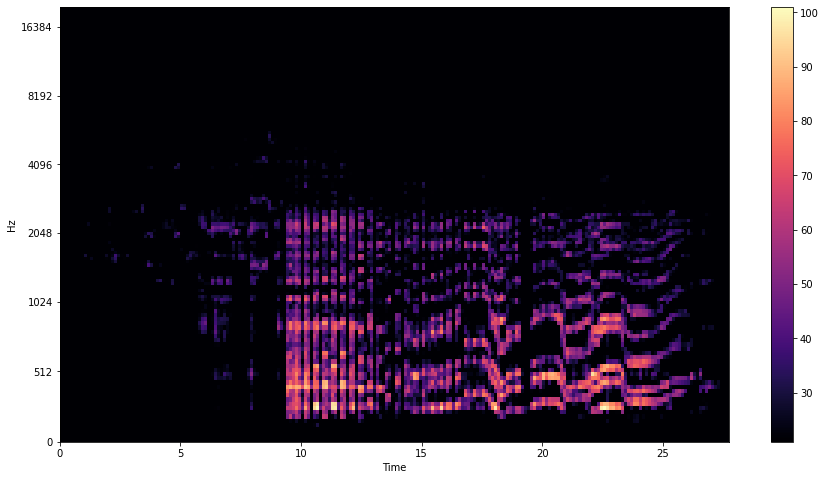

In [ ]:
librosa.display.specshow(
    librosa.amplitude_to_db(data_spec),
    x_axis='time',
    y_axis='mel',
    sr=sr,
    fmax=20000,
    hop_length=HOP_LENGTH,
)
plt.colorbar()
plt.show()

## Re-Arranging the spectogram

The basic idea was to re-order the windows of our spectogram.
Of course we could use any ordering but we want to focus here on an aproach which acounts the characteritics and patterns of our data which is one of the fundamental tasks of data science.

As an trivial ordering of elements is only possible in a single dimension we could use a dimensionality reduction algorithm to reduce the number of our frequency bins to 1.
By reducing it to 1 dimension we obtain a new ordering of our material which is based by the similarity by the content of each time window instead of the original temperal ordering.

We will use 2 algorithms: PCA and TSNE and compare how the differ.
Also we will train each algorithm on a reduction to 1 and to 2 dimensions - 1 dimension is necessary for our ordering but we can observe the characteristics of the algorithm better when using a 2 dimensional plot.

In [ ]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

pca = PCA(n_components=1)
pca_2 = PCA(n_components=2)
tsne = TSNE(n_components=1, random_state=42)
tsne_2 = TSNE(n_components=2, random_state=42)

Instead of working on the raw spectogram data we transfer it to a decibel range which reflects our hearing and perception of amplitude in a better way.

We could also skip go back to amplitude range to compare the performance of the algorithms.

In [ ]:
data_spec_db = librosa.amplitude_to_db(data_spec)

### PCA

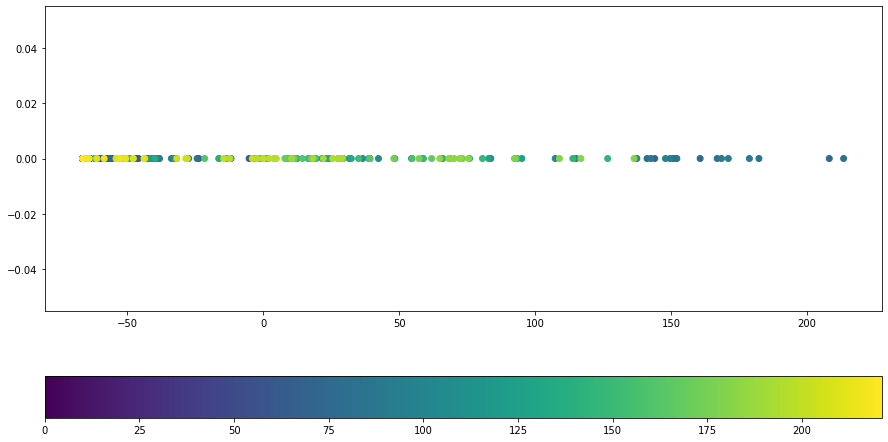

In [ ]:
data_pca = pca.fit_transform(data_spec_db.T)
plt.scatter(x=data_pca, y=np.zeros(data_pca.shape), c=np.arange(len(data_pca)))
#plt.scatter(x=data_pca, y=np.arange(len(data_pca)), c=np.arange(len(data_pca)))

plt.colorbar(location='bottom');

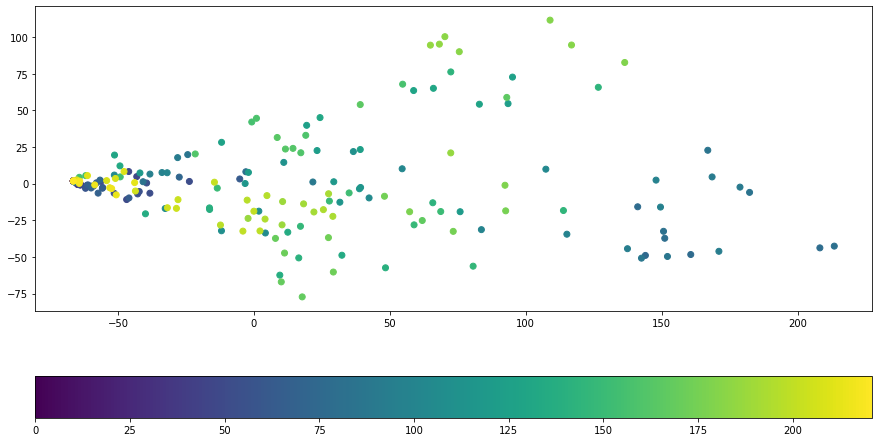

In [ ]:
data_pca_2 = pca_2.fit_transform(data_spec_db.T)
plt.scatter(x=data_pca_2[:, 0], y=data_pca_2[:, 1], c=np.arange((len(data_pca))))
plt.colorbar(location='bottom');

### T-sne

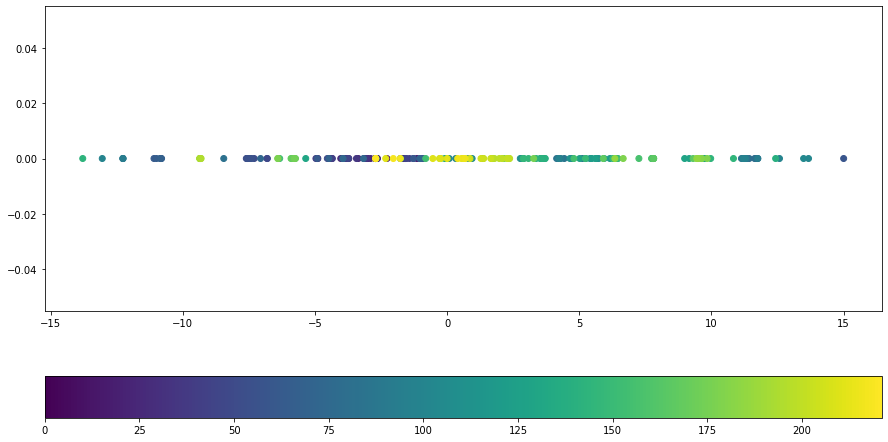

In [ ]:
data_tsne = tsne.fit_transform(data_spec_db.T)
plt.scatter(x=data_tsne, y=np.zeros(data_tsne.shape), c=np.arange(len(data_tsne)))
plt.colorbar(location='bottom');

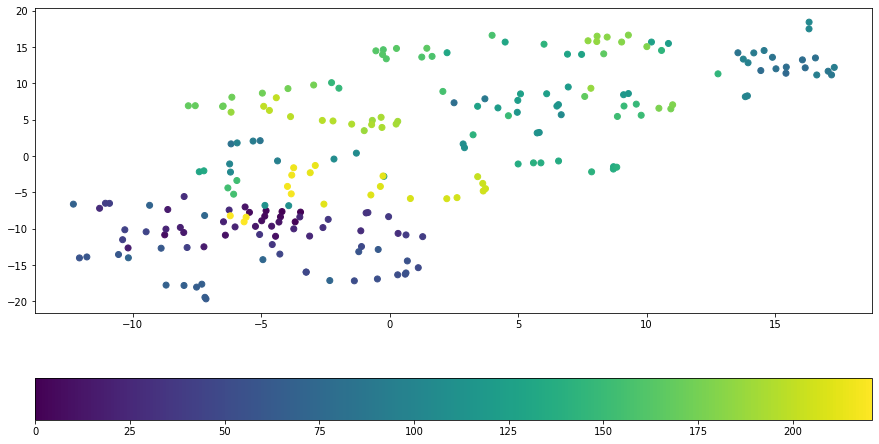

In [ ]:
data_tsne_2 = tsne_2.fit_transform(data_spec_db.T)
plt.scatter(x=data_tsne_2[:, 0], y=data_tsne_2[:, 1], c=np.arange(len(data_tsne)))
plt.colorbar(location='bottom');

When comparing the arragements of PCA and TSNE we see that the structure of TSNE is much mor distinct and has more structure which is reflected by our hearing.

There are some ways to make PCA also distinguish the structure by pre-processing (e.g. amp to decibel) the data and therefore shifting the focus on the aspects of data we want to distinguish.

### Reordering the spectorgram

We can use the 1-dimensional re-ordering of our spectogram as a new ordering of our spectogram.


In [ ]:
order = np.argsort(data_pca[:, 0])
order[[0, 1, 2, 3, 4, 5, 6]]

array([221,   2,   4, 219, 220,   3,   5])

In [ ]:
pca_order = np.argsort(data_pca[:, 0])
print(f"PCA reordering:\n{pca_order}")
fft_pca_order = data_fft[:, pca_order]
signal_pca = librosa.istft(fft_pca_order, hop_length=HOP_LENGTH, win_length=WIN_LENGTH)
display(Audio(signal_pca, rate=sr))

PCA reordering:
[221   2   4 219 220   3   5   6   7  26  11  12  13  23   1   0  14  20
  21  24 113  70  41  25 110  10  31  69  40  19  27   9  15  22  28  36
  34   8  16  45  32  44  74  17  42 211  33  29  30  39  35  38  43  61
 217 155 218  49  18  37  58 154  60 210  66  67  71  59 216  62  68  73
  46  65  57 208 213 215  56 104 130 207 214 133 153 209  50  48  64 212
 206  47  53  55 119  83 136  54  52  95  98 107 101 205 204  92 203  72
  86  51 161 139 138 202 150 198 109 127  63 200 116  80 197 187 121 156
 201 158 108 199 195 106 196 170 164 137 169 188 189 112 171 163 135 162
 141 147 160 168 190 159 125  89 191 122 132 194 173 192 149 193 172 118
 115 134 152 111 117 165 124 114 105 174 140 102 157 177 129 148 167 185
 142 131 184 151 183 186 143 175 182 120 146 128 100 178 176 166 123 126
 103 180 145  99 181 144 179  94  77  88  75  97  96  82  79  87  76  85
  91  93  90  84  78  81]


In [ ]:
tsne_order = np.argsort(data_tsne[:, 0])
print(f"tSNE reordering:\n{tsne_order}")
fft_tsne_order = data_fft[:, tsne_order]
signal_tsne = librosa.istft(fft_tsne_order, hop_length=HOP_LENGTH, win_length=WIN_LENGTH)
display(Audio(signal_tsne, rate=sr))

tSNE reordering:
[143 100  93  88  87  63  64  65  67  68  66 190 191 193 192 194 188 189
 195  82  50  55  53  52  54  56  51  72  47  48 176 177 152 168 169 174
 173 170 131  39  38  62  29  30  49  69  27  40  41  28  73  70  37  33
  32  46  16  35  25  74  36  31  34   9  24 220  11   7   2   4 221   6
   5 219   3   1  14  23  26  13  12   0 110 113  20  21 211  10 218 217
 155  19  15  22  17  44   8  45  42  61  43  18  60  71  59  57 154 210
 208 153 209 130 119 133 212 104 101 216 213 207 215 214  95 206 107 205
 106 204 203 196 197 198 199 200 172 171 202 187 201 109 108 147 136 146
 175 142 135 138 141 137 134 140  83  98  92  86 112  80 111 156 127  89
 150 121 116 105 122 125 115 114 167 124 120 149 118 186 148 117 151 178
 157 159 132 158 161 162 160 163 165 164 129 128 166 184 185 183 182 181
 180 126 123 179 144 145  85  97  91  90  96  84  77  79  75  78  81  94
  76 139  99 103 102  58]


## Re-writing into a class

After we have know the basic procedure of our algorithm we can wrap everything into a class to make it more reusable and also have a single command to run an experiment which allows us to speed up the search for more aesthetic pramaters.

In [ ]:
from typing import Optional, Callable

class SpectReorder:
    def __init__(
        self,
        file_path: str,
        hop_length: Optional[int] = None,
        win_length: Optional[int] = None,
        n_fft: Optional[int] = None,
        sr: Optional[int] = None,
        pre_process: Optional[Callable] = None,
        
    ):
        self.file_path = file_path
        self._data, self._sr = librosa.load(file_path, sr=sr, mono=True)
        
        self.hop_length = hop_length if hop_length else int(self._sr/2)
        self.win_length = win_length if win_length else int(self._sr)
        self.n_fft = n_fft if n_fft else self.win_length
        
        self._fft = librosa.stft(
            self._data,
            n_fft=self.n_fft,
            hop_length=self.hop_length,
            win_length=self.win_length,
        )
        
        self._spectogram = librosa.feature.melspectrogram(
            self._data,
            sr=self._sr,
            hop_length=self.hop_length,
            win_length=self.win_length,
            n_fft=self.n_fft
        )
        self.pre_process = pre_process if pre_process else lambda x: librosa.amplitude_to_db(x)
    
    def run_algorithm(self, dim_reduction = None):
        dim_reduction = dim_reduction if dim_reduction else TSNE(n_components=1)
        spect = self.pre_process(self._spectogram)
        spect_reduced = dim_reduction.fit_transform(spect.T)
        fft_re_order = self._fft[:, np.argsort(spect_reduced[:, 0])]
        reordered_signal = librosa.istft(
            fft_re_order,
            hop_length=self.hop_length,
            win_length=self.win_length,
        )
        return reordered_signal

In [ ]:
experiment = SpectReorder('violin.flac', hop_length=400, win_length=2000, sr=44100)
signal = experiment.run_algorithm()
display(Audio(signal, rate=experiment._sr))

Now we can tweak all parameters of our algorithm in a single line and compare multiple results because the config of the algorithm is now attached to the instance of our experiment and not shared globally by every experiment.

## Fine tuning the results

While listening to the results at least the PCA aproach relies too much on the amplitude of the signal and not on its 

In [ ]:
volume_scaling = lambda x: librosa.amplitude_to_db(x/np.sum(x, axis=1)[:, np.newaxis])

In [ ]:
experiment = SpectReorder(
    'violin.flac',
    hop_length=400,
    win_length=2000,
    sr=44100,
    pre_process=volume_scaling
)
signal = experiment.run_algorithm()
display(Audio(signal, rate=experiment._sr))

We can also apply a scaling on each frequency so that he higher frequencies are less important for our clustering than the low frequencies.
We can use an inversed log scale for this and multiply a matrix of these value to our spectogram.

In [ ]:
log_scaling = lambda x: np.matmul(np.repeat(np.log(np.arange(len(x)+1, 1, -1))[np.newaxis, :], len(x), axis=0), x)

In [ ]:
experiment = SpectReorder(
    'violin.flac',
    hop_length=400,
    win_length=2000,
    sr=44100,
    pre_process=log_scaling
)
signal = experiment.run_algorithm()
display(Audio(signal, rate=experiment._sr))

We can now combine these two pre-processing steps into one by nesting the functions.

In [ ]:
experiment = SpectReorder(
    'violin.flac',
    hop_length=400,
    win_length=2000,
    sr=44100,
    pre_process=lambda x: log_scaling(volume_scaling(x))
)
signal = experiment.run_algorithm()
display(Audio(signal, rate=experiment._sr))

## Where to go from here

Currently we are not considering the cluster of similar grains.
Instead of playing them in their ordinal order we could play them according to the distance of their reduced dimensionality.

We also restricted ourselves to a 1 dimensional reduction as the ordering then becomes trivial. But by moving to higher dimensions the replacing of samples could be composed via [n nearest neighbors](https://scikit-learn.org/stable/modules/neighbors.html).